<a href="https://colab.research.google.com/github/seansothey/CSC685/blob/master/Project8_CNN_Face_Expression.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

![alt text](https://miro.medium.com/max/1200/1*Tdz9Pm3pTT75ix1yZDCSLg.png)

Facial expression recognition systems have attracted
much research interest within the field of artificial intelligence. Many established facial expression recognition
(FER) systems apply standard machine learning to extracted image features, and these methods generalize poorly
to previously unseen data. This project builds upon recent research to classify images of human faces into discrete emotion categories using convolutional neural networks (CNNs). We experimented with three different numbers of layers. Other methods such as max-pooling, fully connected dense layers, and data augmentation, were also used to increase accuracies for the six classes classification task.

**Image Datasets:**

There're 72 images of 6 people's face expression. Each person showed 6 different expression, such as 'anger', 'disgust', 'fear', 'happiness', 'neutrality' and 'sadness'. Each expression was captured 2 times.

https://faces.mpdl.mpg.de/imeji/collections?q=

**Machine Learning Techniques:** 


*   CNN 1,2,3 layers
*   Max-Pooling
*   Data Augumentation

**Additionl Tools:**


*   Github & Kaggle: for hosting datasets and python notebook
*   Tableau: for report visualization









#Setup

In [1]:
# Common Import
import sklearn
import pandas as pd
import numpy as np
from sklearn import metrics
import seaborn as sns
import os
import time
import random

import tarfile
import cv2
from google.colab.patches import cv2_imshow

# to make this notebook's output stable across runs
np.random.seed(42)

from zipfile import ZipFile

from keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler,LabelEncoder

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Ignore useless warnings (see SciPy issue #5998)
import warnings
warnings.filterwarnings(action="ignore")

# sklearn version > 0.20 is required 
sklearn.__version__
# Update sklearn -> !pip install -U scikit-learn

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm
Using TensorFlow backend.


'0.22.2.post1'

#Custom Functions

This is a fucntion to download a file using **URL**. Then save it in the **save_path** with **target_file_name**. If target_file_name is empty, then the file name will be gotten from the URL.

In [0]:
import urllib
import urllib.parse as parse

def download(url,save_path,target_file_name=''):
  print("file is being downloading from {} ...".format(url))
  file = urllib.request.urlopen(url)
  fileData = file.read()

  if target_file_name=='':
    split=parse.urlsplit(url)
    target_file_name = split.path.split('/')[-1]
  
  if not os.path.exists(save_path):
    os.mkdir(save_path)

  targetFile = os.path.join(save_path,target_file_name)
  with open(targetFile,'wb') as f:
    f.write(fileData)
  print('Done, file in the path {}'.format(targetFile))

This is a function to extract tar file in the **tar_file_path**, which includes the file name and the extension, to **target_path**.

In [0]:
def extractTar(tar_file_path,target_path):
    print("Extracting is starting....")
    tar=tarfile.open(tar_file_path)
    tar.extractall(target_path)
    tar.close()
    print("Done")

This is a function to extract zip file in the **zip_file_path**, which includes the file name and the extension, to **target_path**.

In [0]:
def extractZip(zip_file_path,target_path):
    print("Extracting is starting....")
    zFile=ZipFile(zip_file_path)
    zFile.extractall(target_path)
    zFile.close()
    print("Done")

This is a custom function to create a imgs set without labels, unsupervised dataset. It used the folder path of the imgs.

In [0]:
def create_img_set(imgs_folder_path):
  x=[]
  lst = os.listdir(imgs_folder_path)
  for img in lst:
    img_imr = cv2.imread(os.path.join(imgs_folder_path,img))
    img_imr = cv2.resize(img_imr,(256,256))
    x.append(np.array(img_imr))
  return x

randomly_sho_imgs is for randomly display nrows x ncols images from the training set 

In [0]:
def randomly_show_imgs(x_set,nrows,ncols):
  #plt.figure(figsize=(10,10))
  for i in range(nrows*ncols):
    plt.subplot(nrows,ncols,i+1)
    indx = random.randint(0,len(x_set))
    plt.cv2.imshow(x_set[indx])
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
  plt.show()

reduceTo2D fucntion is to reduce the dimensionality of dataset to 2D using t-SNE algorithm

In [0]:
from sklearn.manifold import TSNE

def reduceTo2D(dataset):
  tsne = TSNE(n_components=2,random_state=47)
  reduced_dataset=tsne.fit_transform(dataset)
  return reduced_dataset

getRandomSubset is a function a give a shuffled subset with a specific size. It is using train_test_split to generate the subset


In [0]:
def getRandomSubset(dataset, subset_size):
  subset_size_percentage = subset_size/len(dataset)
  x_train,x_test=train_test_split(dataset,test_size=subset_size_percentage,random_state=47,shuffle=True)
  print('subset {}'.format(x_test.shape))
  return x_test


## Preprocessing Data

In [0]:
root_path = 'data'
if not os.path.exists(root_path):
  os.mkdir(root_path)

In [10]:
download('https://storage.googleapis.com/kaggle-data-sets/633155/1126184/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1588754502&Signature=S%2Fpoax1CqE1qKjjp4QTMD5e0UG4KuXlFJpnTJspH1m9FrrwT5EZSvgcGbyCVq9YmhslZOtBtdR3Zgq7ZTO51z1uu0WPfLOA3epbZtCTHaTxmXSmPv2zCa9cFHNMxqbSRsU9v1UxgZQnsojKrNfeId4nJTJpKjwCNLzj9LMNWVtnLTs%2Bb67pf7lSPYchUZOD%2Fowwa4KOun45ygI%2BJ1E52Dw2t8QRnEwckdU84%2Bod70CtfPLuF3GzPOpRiud2W%2FxfvOcf9skIsNvXfmlLYwPPjSy97kkJk0u6MCumT7rkeSnyZc9gZe9N%2BUYfkW6g2d9yePaVPGSfUh1fr0m4poxd8RA%3D%3D&response-content-disposition=attachment%3B+filename%3Dface-train.zip',os.path.join(root_path,'Faces'),'face_train.zip')

file is being downloading from https://storage.googleapis.com/kaggle-data-sets/633155/1126184/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1588754502&Signature=S%2Fpoax1CqE1qKjjp4QTMD5e0UG4KuXlFJpnTJspH1m9FrrwT5EZSvgcGbyCVq9YmhslZOtBtdR3Zgq7ZTO51z1uu0WPfLOA3epbZtCTHaTxmXSmPv2zCa9cFHNMxqbSRsU9v1UxgZQnsojKrNfeId4nJTJpKjwCNLzj9LMNWVtnLTs%2Bb67pf7lSPYchUZOD%2Fowwa4KOun45ygI%2BJ1E52Dw2t8QRnEwckdU84%2Bod70CtfPLuF3GzPOpRiud2W%2FxfvOcf9skIsNvXfmlLYwPPjSy97kkJk0u6MCumT7rkeSnyZc9gZe9N%2BUYfkW6g2d9yePaVPGSfUh1fr0m4poxd8RA%3D%3D&response-content-disposition=attachment%3B+filename%3Dface-train.zip ...
Done, file in the path data/Faces/face_train.zip


In [11]:
extractZip('data/Faces/face_train.zip', 'data/train/imgs')

Extracting is starting....
Done


In [12]:
download('https://storage.googleapis.com/kaggle-data-sets/633156/1126185/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1588754936&Signature=GSDi0WhvK%2BOqgy0CWBmYz4rNLtkT2a2GRmxZEt3NM%2BHSsj86c21Zx1hqcDxMu5xOtV%2FnvZIScdVCvk3fnpw2xJHdJGNsOOnI%2FVuCi5IvxqxqVeuvG8VU3NIHQi1ZviffSq5zIdTu0ozcDBR9sbLdBTKTifAC%2BtLSqGj3qpgKstjggSsLMCbAFBDUrhc5tJrlO2erkYlB2oQl1RXH8sVrWYFDXlnMimCERisNCf6HMuVqxEDwKTJ9%2FQzI4L9SI6CwYWoJpHCvADQv%2FpTOpb3IFqQrMgveYBjsSS9P%2FMQmjauFz7n425HMfj6EwnbvtSsDyrXhDTGdWCSFRZEQQfdBFw%3D%3D&response-content-disposition=attachment%3B+filename%3Dface-test.zip',os.path.join(root_path,'Faces'),'face_test.zip')

file is being downloading from https://storage.googleapis.com/kaggle-data-sets/633156/1126185/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1588754936&Signature=GSDi0WhvK%2BOqgy0CWBmYz4rNLtkT2a2GRmxZEt3NM%2BHSsj86c21Zx1hqcDxMu5xOtV%2FnvZIScdVCvk3fnpw2xJHdJGNsOOnI%2FVuCi5IvxqxqVeuvG8VU3NIHQi1ZviffSq5zIdTu0ozcDBR9sbLdBTKTifAC%2BtLSqGj3qpgKstjggSsLMCbAFBDUrhc5tJrlO2erkYlB2oQl1RXH8sVrWYFDXlnMimCERisNCf6HMuVqxEDwKTJ9%2FQzI4L9SI6CwYWoJpHCvADQv%2FpTOpb3IFqQrMgveYBjsSS9P%2FMQmjauFz7n425HMfj6EwnbvtSsDyrXhDTGdWCSFRZEQQfdBFw%3D%3D&response-content-disposition=attachment%3B+filename%3Dface-test.zip ...
Done, file in the path data/Faces/face_test.zip


In [13]:
extractZip('data/Faces/face_test.zip', 'data/test/imgs')

Extracting is starting....
Done


In [0]:
face_train = os.listdir('data/train/imgs/Face_Train')

In [15]:
len(face_train)

60

In [0]:
face_test = os.listdir('data/test/imgs/Face_Test')

In [17]:
len(face_test)

12

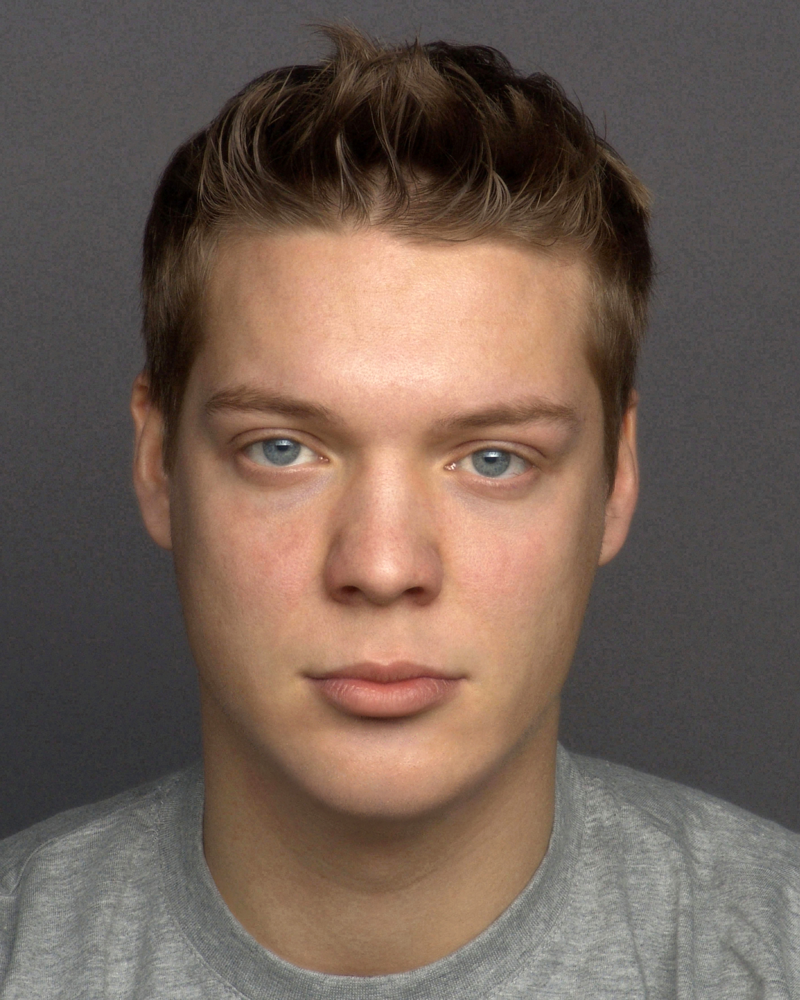

image size (3543, 2835, 3) 


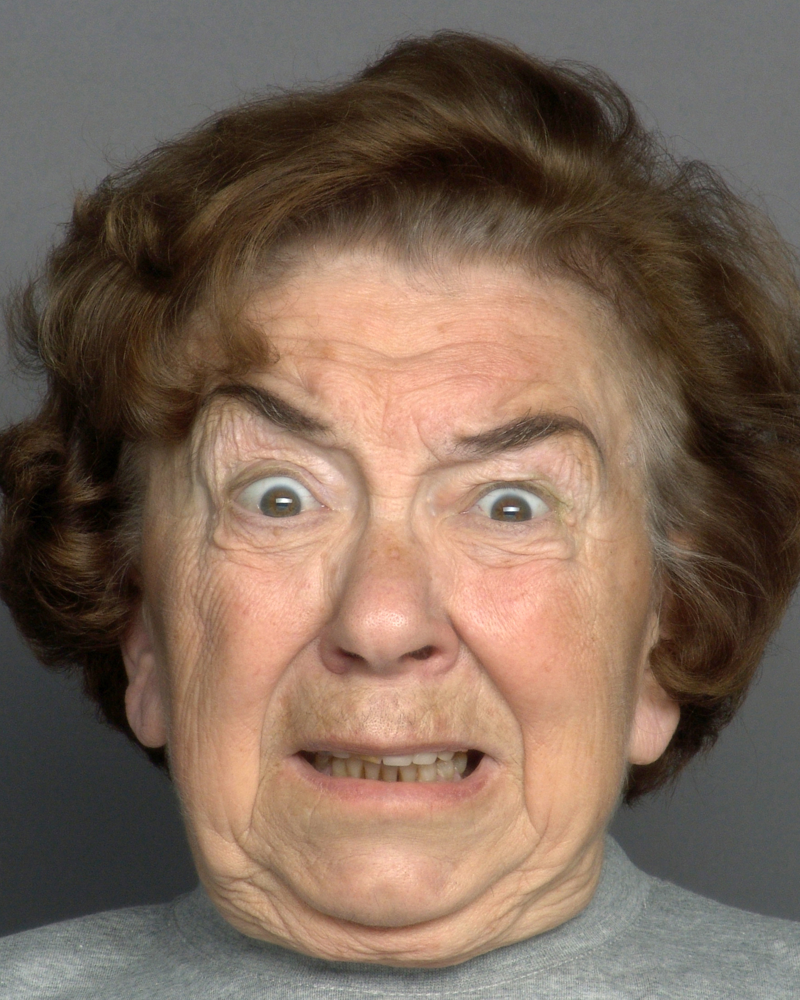

image size (3543, 2835, 3) 


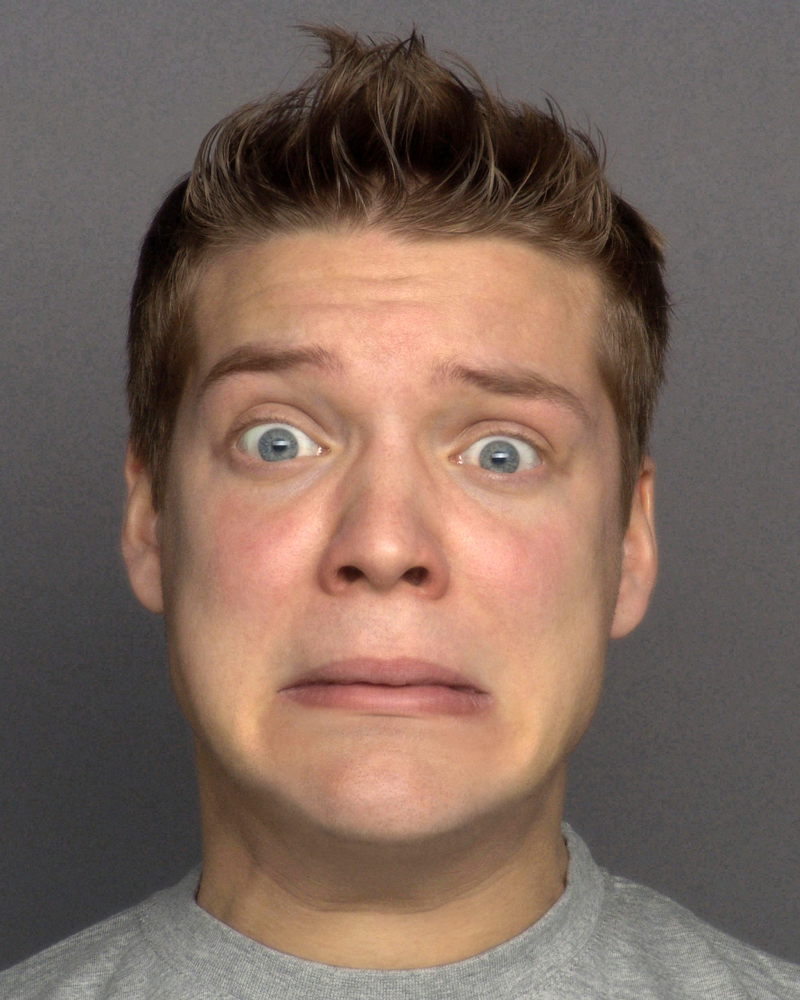

image size (3543, 2835, 3) 


In [18]:
# Plot to see some images of the dataset
for i in range(3):
  rndIndx = random.randint(0,len(face_train)-1)
  img = cv2.imread(os.path.join('data/train/imgs/Face_Train',face_train[rndIndx]))
  cv2_imshow(img)
  print('image size {} '.format(img.shape))


###Create the images dataset

In [0]:
X_train = create_img_set(os.path.join('data/train/imgs/Face_Train'))

In [0]:
X_test = create_img_set(os.path.join('data/test/imgs/Face_Test'))

Show some randomly images from the training set

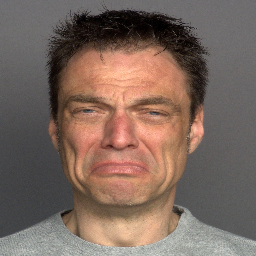

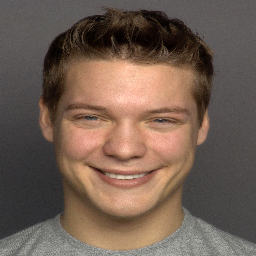

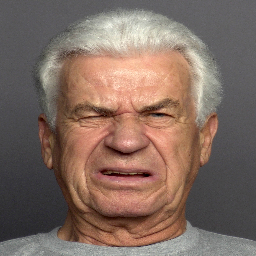

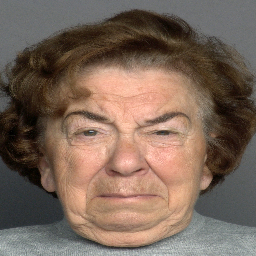

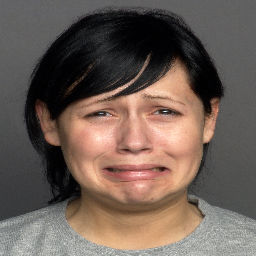

...

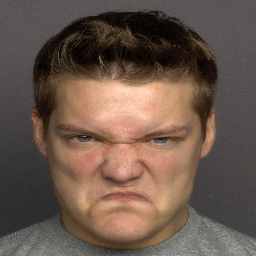

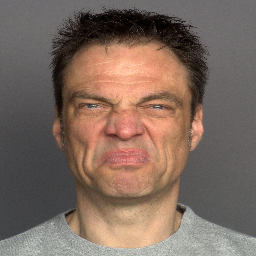

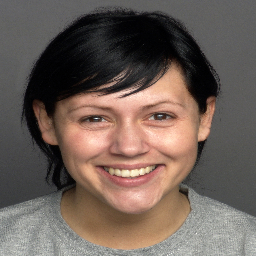

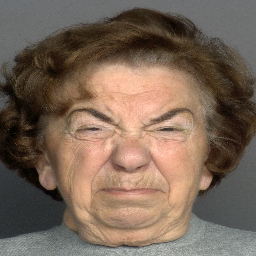

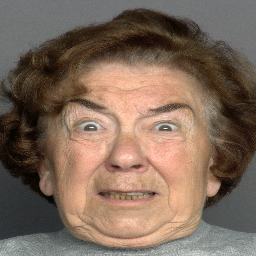

In [21]:
for i in range(0,12):
  cv2_imshow(X_train[i])

###Flattening the dataset

In [0]:
X_train = np.array(X_train)
X_test = np.array(X_test)

In [23]:
X_train.shape, X_test.shape

((60, 256, 256, 3), (12, 256, 256, 3))

###Create label y manually

In [0]:
label = ['anger','disgust','fear','happiness','neutrality','sadness']

In [0]:
#y_train = [[5],[3],[1],[5],[5],[3],[5],[0],[1],[3],
#           [1],[2],[3],[0],[1],[5],[4],[3],[4],[2],
#           [4],[0],[3],[0],[1],[3],[2],[0],[1],[5],
#           [2],[2],[3],[5],[4],[0],[4],[4],[5],[3],
#           [5],[2],[1],[4],[0],[1],[2],[4],[0],[2],
#           [5],[2],[4],[0],[4],[0],[5],[1],[2],[5]]

In [0]:
y_train = [5,3,1,5,5,3,5,0,1,3,
           1,2,3,0,1,5,4,3,4,2,
           4,0,3,0,1,3,2,0,1,5,
           2,2,3,5,4,0,4,4,5,3,
           5,2,1,4,0,1,2,4,0,2,
           5,2,4,0,4,0,5,1,2,5]

In [0]:
y_train = to_categorical(y_train,num_classes=len(label))

In [0]:
#y_test = [[5],[1],[3],[0],[2],[4],
#          [0],[4],[5],[2],[1],[3]]

In [0]:
y_actual = [5,1,3,0,2,4,0,4,5,2,1,3]

In [0]:
y_test = to_categorical(y_actual,num_classes=len(label))

##CNN 1-layer 

In [0]:
import keras
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D

cnn1 = Sequential([
    Conv2D(32, kernel_size=(3, 3), activation='relu',padding='same',input_shape=(256,256,3)),
    MaxPooling2D(pool_size=(2, 2),strides=2),
    Flatten(),
    Dense(512, activation='relu'),
    Dense(64, activation='relu'),
    Dense(6, activation='softmax')
])

In [0]:
cnn1.compile(loss=keras.losses.categorical_crossentropy,
              optimizer=keras.optimizers.Adam(),
              metrics=['accuracy'])

In [75]:
cnn1.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_11 (Conv2D)           (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 128, 128, 32)      0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 524288)            0         
_________________________________________________________________
dense_15 (Dense)             (None, 512)               268435968 
_________________________________________________________________
dense_16 (Dense)             (None, 64)                32832     
_________________________________________________________________
dense_17 (Dense)             (None, 6)                 390       
Total params: 268,470,086
Trainable params: 268,470,086
Non-trainable params: 0
________________________________________

###Training the model

In [76]:
tr1 = cnn1.fit(X_train, y_train,
          batch_size=3,
          epochs=20,
          verbose=1,
          validation_data=(X_train[:20], y_train[:20]))

Train on 60 samples, validate on 20 samples
Epoch 1/20
60/60 [==============================] - 12s 202ms/step - loss: 14702.5725 - accuracy: 0.1167 - val_loss: 5798.4618 - val_accuracy: 0.1000
Epoch 2/20
60/60 [==============================] - 12s 198ms/step - loss: 2078.3148 - accuracy: 0.1167 - val_loss: 65.1463 - val_accuracy: 0.1500
Epoch 3/20
60/60 [==============================] - 12s 199ms/step - loss: 14.2102 - accuracy: 0.6000 - val_loss: 5.4074 - val_accuracy: 0.8000
Epoch 4/20
60/60 [==============================] - 12s 193ms/step - loss: 3.5031 - accuracy: 0.8667 - val_loss: 0.5739 - val_accuracy: 0.9500
Epoch 5/20
60/60 [==============================] - 12s 196ms/step - loss: 1.6800 - accuracy: 0.9000 - val_loss: 0.3955 - val_accuracy: 0.9500
Epoch 6/20
60/60 [==============================] - 12s 196ms/step - loss: 0.2919 - accuracy: 0.9833 - val_loss: 7.4321e-06 - val_accuracy: 1.0000
Epoch 7/20
60/60 [==============================] - 12s 198ms/step - loss: 4.2992e

###See the accuracy

In [77]:
score1 = cnn1.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score1[0])
print('Test accuracy:', score1[1])

Test loss: 19.24509620666504
Test accuracy: 0.3333333432674408


It's very low, let's try some more layers and augument dataset.

###See the prediction

In [0]:
pred1 = cnn1.predict_classes(X_test, verbose=0)

In [79]:
pred1

array([5, 5, 5, 5, 2, 2, 5, 5, 5, 2, 5, 5])

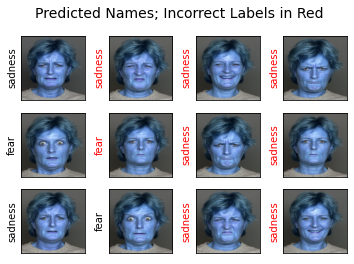

In [80]:
fig, ax = plt.subplots(3, 4)
for i, axi in enumerate(ax.flat):
    axi.imshow(X_test[i], cmap='bone')
    axi.set(xticks=[], yticks=[])
    axi.set_ylabel(label[pred1[i]].split()[-1],
                   color='black' if pred1[i] == y_actual[i] else 'red')
fig.suptitle('Predicted Names; Incorrect Labels in Red', size=14);

###Plot the learning curve

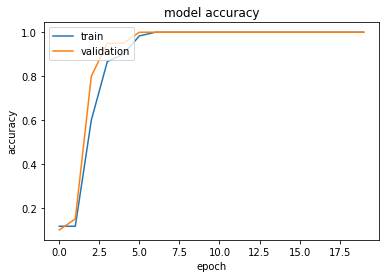

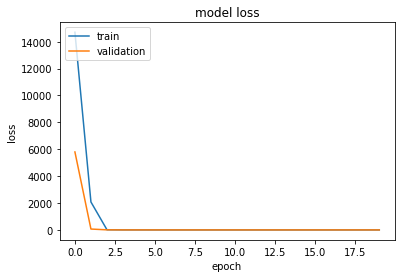

In [113]:
plt.plot(tr1.history['accuracy'])
plt.plot(tr1.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# summarize history for loss
plt.plot(tr1.history['loss'])
plt.plot(tr1.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

###Classification Report

In [82]:
from sklearn.metrics import classification_report
#target_names = ["Class {}".format(i) for i in range(6)]
print(classification_report(y_actual, pred1, target_names=label))

              precision    recall  f1-score   support

       anger       0.00      0.00      0.00         2
     disgust       0.00      0.00      0.00         2
        fear       0.67      1.00      0.80         2
   happiness       0.00      0.00      0.00         2
  neutrality       0.00      0.00      0.00         2
     sadness       0.22      1.00      0.36         2

    accuracy                           0.33        12
   macro avg       0.15      0.33      0.19        12
weighted avg       0.15      0.33      0.19        12



###Data Augumentation

In [0]:
from keras.preprocessing.image import ImageDataGenerator
gen = ImageDataGenerator(rotation_range=16, width_shift_range=0.2, shear_range=0.2, height_shift_range=0.2, zoom_range=0.2, 
                         featurewise_center=True, horizontal_flip=True, featurewise_std_normalization=True)
batches = gen.flow(X_train, y_train, batch_size=6)
val_batches = gen.flow(X_train[:20], y_train[:20], batch_size=5)

###Train model with augumented data

In [84]:
tr1_aug = cnn1.fit_generator(batches, steps_per_epoch=60//3, epochs=20,
                    validation_data=val_batches, validation_steps=20//5, use_multiprocessing=True)

Epoch 1/20
20/20 [==============================] - 23s 1s/step - loss: 15.2839 - accuracy: 0.2417 - val_loss: 5.9614 - val_accuracy: 0.1000
Epoch 2/20
20/20 [==============================] - 24s 1s/step - loss: 11.3159 - accuracy: 0.1667 - val_loss: 8.6719 - val_accuracy: 0.1000
Epoch 3/20
20/20 [==============================] - 23s 1s/step - loss: 7.4258 - accuracy: 0.1583 - val_loss: 9.5267 - val_accuracy: 0.1000
Epoch 4/20
20/20 [==============================] - 23s 1s/step - loss: 5.4319 - accuracy: 0.2083 - val_loss: 7.0601 - val_accuracy: 0.2000
Epoch 5/20
20/20 [==============================] - 24s 1s/step - loss: 5.9500 - accuracy: 0.1583 - val_loss: 10.6366 - val_accuracy: 0.2000
Epoch 6/20
20/20 [==============================] - 23s 1s/step - loss: 5.9973 - accuracy: 0.1750 - val_loss: 8.7367 - val_accuracy: 0.1500
Epoch 7/20
20/20 [==============================] - 24s 1s/step - loss: 5.5459 - accuracy: 0.1833 - val_loss: 6.0782 - val_accuracy: 0.1000
Epoch 8/20
20/20 

See the accuracy after augumentation

In [85]:
score1_aug = cnn1.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score1_aug[0])
print('Test accuracy:', score1_aug[1])

Test loss: 4.381641387939453
Test accuracy: 0.3333333432674408


##CNN 3-layers 

In [0]:
cnn3 = Sequential([
    Conv2D(32, kernel_size=(3, 3), activation='relu',padding='same',input_shape=(256,256,3)),  # 1st layer
    MaxPooling2D(pool_size=(2, 2),strides=2),

    Conv2D(32, kernel_size=(3,3), activation='relu', padding='same'), # 2nd layer
    MaxPooling2D(pool_size=(2,2), strides=2),

    Conv2D(64, kernel_size=(3,3), activation='relu'), # 3rd layer
    MaxPooling2D(pool_size=(2,2), strides=2),

    Flatten(),
    Dense(512, activation='relu'),
    Dense(128, activation='relu'),
    Dense(32, activation='relu'),
    Dense(6, activation='softmax')
])

In [0]:
cnn3.compile(loss=keras.losses.categorical_crossentropy,
              optimizer=keras.optimizers.Adam(),
              metrics=['accuracy'])

In [88]:
cnn3.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_12 (Conv2D)           (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d_12 (MaxPooling (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 128, 128, 32)      9248      
_________________________________________________________________
max_pooling2d_13 (MaxPooling (None, 64, 64, 32)        0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 62, 62, 64)        18496     
_________________________________________________________________
max_pooling2d_14 (MaxPooling (None, 31, 31, 64)        0         
_________________________________________________________________
flatten_6 (Flatten)          (None, 61504)            

###Training the model

In [89]:
tr3 = cnn3.fit(X_train, y_train,
          batch_size=3,
          epochs=20,
          verbose=1,
          validation_data=(X_train[:20], y_train[:20]))

Train on 60 samples, validate on 20 samples
Epoch 1/20
60/60 [==============================] - 3s 48ms/step - loss: 224.5885 - accuracy: 0.1333 - val_loss: 3.4068 - val_accuracy: 0.2000
Epoch 2/20
60/60 [==============================] - 3s 45ms/step - loss: 2.4042 - accuracy: 0.2667 - val_loss: 1.6471 - val_accuracy: 0.4000
Epoch 3/20
60/60 [==============================] - 3s 45ms/step - loss: 1.6865 - accuracy: 0.3833 - val_loss: 1.4018 - val_accuracy: 0.5500
Epoch 4/20
60/60 [==============================] - 3s 45ms/step - loss: 1.4840 - accuracy: 0.4833 - val_loss: 1.2478 - val_accuracy: 0.7500
Epoch 5/20
60/60 [==============================] - 3s 45ms/step - loss: 1.0058 - accuracy: 0.7167 - val_loss: 0.6562 - val_accuracy: 0.8000
Epoch 6/20
60/60 [==============================] - 3s 45ms/step - loss: 0.4892 - accuracy: 0.8333 - val_loss: 0.1370 - val_accuracy: 1.0000
Epoch 7/20
60/60 [==============================] - 3s 46ms/step - loss: 0.1262 - accuracy: 0.9833 - val_los

###See the accuracy

In [90]:
score3 = cnn3.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score3[0])
print('Test accuracy:', score3[1])

Test loss: 3.0245800018310547
Test accuracy: 0.1666666716337204


###See the prediction

In [0]:
pred3 = cnn3.predict_classes(X_test, verbose=0)

In [92]:
pred3

array([3, 4, 3, 4, 3, 1, 3, 3, 3, 5, 3, 3])

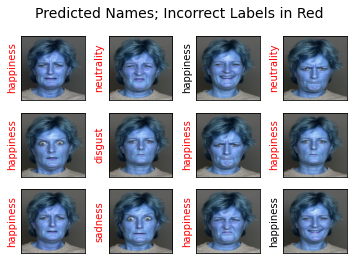

In [93]:
fig, ax = plt.subplots(3, 4)
for i, axi in enumerate(ax.flat):
    axi.imshow(X_test[i], cmap='bone')
    axi.set(xticks=[], yticks=[])
    axi.set_ylabel(label[pred3[i]].split()[-1],
                   color='black' if pred3[i] == y_actual[i] else 'red')
fig.suptitle('Predicted Names; Incorrect Labels in Red', size=14);

###Plot the learning curve

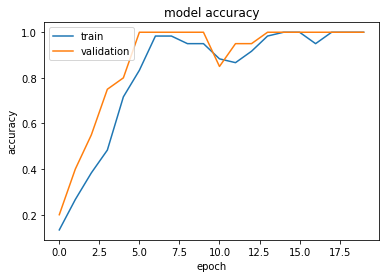

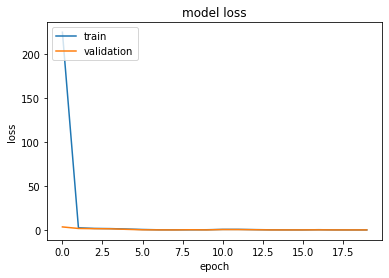

In [112]:
plt.plot(tr3.history['accuracy'])
plt.plot(tr3.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# summarize history for loss
plt.plot(tr3.history['loss'])
plt.plot(tr3.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

###Classification Report

In [95]:
from sklearn.metrics import classification_report
#target_names = ["Class {}".format(i) for i in range(6)]
print(classification_report(y_actual, pred3, target_names=label))

              precision    recall  f1-score   support

       anger       0.00      0.00      0.00         2
     disgust       0.00      0.00      0.00         2
        fear       0.00      0.00      0.00         2
   happiness       0.25      1.00      0.40         2
  neutrality       0.00      0.00      0.00         2
     sadness       0.00      0.00      0.00         2

    accuracy                           0.17        12
   macro avg       0.04      0.17      0.07        12
weighted avg       0.04      0.17      0.07        12



###Train model with augumented data

In [96]:
tr3_aug = cnn3.fit_generator(batches, steps_per_epoch=60//3, epochs=20,
                    validation_data=val_batches, validation_steps=20//5, use_multiprocessing=True)

Epoch 1/20
20/20 [==============================] - 6s 321ms/step - loss: 1.9941 - accuracy: 0.2000 - val_loss: 1.7802 - val_accuracy: 0.3000
Epoch 2/20
20/20 [==============================] - 7s 336ms/step - loss: 1.8194 - accuracy: 0.2250 - val_loss: 1.4471 - val_accuracy: 0.3000

Epoch 3/20
20/20 [==============================] - 7s 348ms/step - loss: 1.8157 - accuracy: 0.2250 - val_loss: 1.7844 - val_accuracy: 0.2000
Epoch 4/20
20/20 [==============================] - 7s 332ms/step - loss: 1.7939 - accuracy: 0.2250 - val_loss: 1.5508 - val_accuracy: 0.1500
Epoch 5/20
20/20 [==============================] - 7s 347ms/step - loss: 1.8115 - accuracy: 0.1917 - val_loss: 1.7460 - val_accuracy: 0.2500
Epoch 6/20
20/20 [==============================] - 6s 318ms/step - loss: 1.7691 - accuracy: 0.2417 - val_loss: 1.7890 - val_accuracy: 0.1500
Epoch 7/20
20/20 [==============================] - 7s 336ms/step - loss: 1.7966 - accuracy: 0.2083 - val_loss: 1.8899 - val_accuracy: 0.2500
Epoch

See the accuracy after augumentation

In [97]:
score3_aug = cnn3.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score3_aug[0])
print('Test accuracy:', score3_aug[1])

Test loss: 1.81202232837677
Test accuracy: 0.1666666716337204


##CNN 5-layers 

In [0]:
cnn5 = Sequential([
    Conv2D(32, kernel_size=(3, 3), activation='relu',padding='same',input_shape=(256,256,3)),  # 1st layer
    MaxPooling2D(pool_size=(2, 2),strides=2),

    Conv2D(32, kernel_size=(3,3), activation='relu', padding='same'), # 2nd layer
    MaxPooling2D(pool_size=(2,2), strides=2),

    Conv2D(32, kernel_size=(3,3), activation='relu'), # 3rd layer
    MaxPooling2D(pool_size=(2,2), strides=2),

    Conv2D(64, kernel_size=(3,3), activation='relu'), # 4th layer
    MaxPooling2D(pool_size=(2,2), strides=2),

    Conv2D(64, kernel_size=(3,3), activation='relu'), # 5th layer
    MaxPooling2D(pool_size=(2,2), strides=2),

    Flatten(),
    Dense(512, activation='relu'),
    Dense(128, activation='relu'),
    Dense(32, activation='relu'),
    Dense(6, activation='softmax')
])

In [0]:
cnn5.compile(loss=keras.losses.categorical_crossentropy,
              optimizer=keras.optimizers.Adam(),
              metrics=['accuracy'])

In [100]:
cnn5.summary()

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_15 (Conv2D)           (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d_15 (MaxPooling (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 128, 128, 32)      9248      
_________________________________________________________________
max_pooling2d_16 (MaxPooling (None, 64, 64, 32)        0         
_________________________________________________________________
conv2d_17 (Conv2D)           (None, 62, 62, 32)        9248      
_________________________________________________________________
max_pooling2d_17 (MaxPooling (None, 31, 31, 32)        0         
_________________________________________________________________
conv2d_18 (Conv2D)           (None, 29, 29, 64)       

###Training the model

In [101]:
tr5 = cnn5.fit(X_train, y_train,
          batch_size=3,
          epochs=20,
          verbose=1,
          validation_data=(X_train[:20], y_train[:20]))

Train on 60 samples, validate on 20 samples
Epoch 1/20
60/60 [==============================] - 2s 30ms/step - loss: 5.7002 - accuracy: 0.1333 - val_loss: 1.7885 - val_accuracy: 0.2500
Epoch 2/20
60/60 [==============================] - 2s 26ms/step - loss: 1.8337 - accuracy: 0.1000 - val_loss: 1.7604 - val_accuracy: 0.3500
Epoch 3/20
60/60 [==============================] - 2s 26ms/step - loss: 1.7909 - accuracy: 0.1500 - val_loss: 1.7719 - val_accuracy: 0.2000
Epoch 4/20
60/60 [==============================] - 2s 26ms/step - loss: 1.7975 - accuracy: 0.1667 - val_loss: 1.7538 - val_accuracy: 0.3500
Epoch 5/20
60/60 [==============================] - 2s 26ms/step - loss: 1.7776 - accuracy: 0.2500 - val_loss: 1.6965 - val_accuracy: 0.4000
Epoch 6/20
60/60 [==============================] - 2s 25ms/step - loss: 1.6730 - accuracy: 0.4000 - val_loss: 1.3491 - val_accuracy: 0.6500
Epoch 7/20
60/60 [==============================] - 2s 26ms/step - loss: 1.4514 - accuracy: 0.4667 - val_loss:

###See the accuracy

In [102]:
score5 = cnn5.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score5[0])
print('Test accuracy:', score5[1])

Test loss: 2.104775905609131
Test accuracy: 0.3333333432674408


###See the prediction

In [0]:
pred5 = cnn5.predict_classes(X_test)

In [104]:
pred5

array([5, 0, 5, 0, 2, 5, 0, 5, 3, 3, 0, 5])

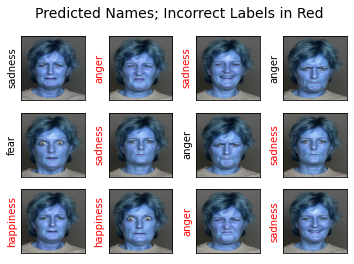

In [105]:
fig, ax = plt.subplots(3, 4)
for i, axi in enumerate(ax.flat):
    axi.imshow(X_test[i], cmap='bone')
    axi.set(xticks=[], yticks=[])
    axi.set_ylabel(label[pred5[i]].split()[-1],
                   color='black' if pred5[i] == y_actual[i] else 'red')
fig.suptitle('Predicted Names; Incorrect Labels in Red', size=14);

###Plot the learning curve

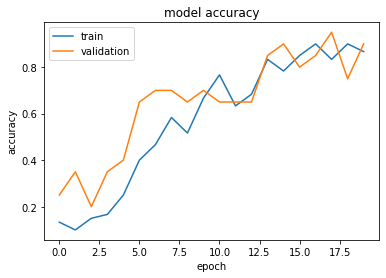

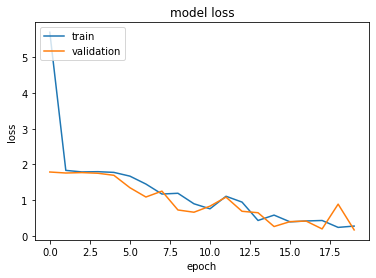

In [111]:
plt.plot(tr5.history['accuracy'])
plt.plot(tr5.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# summarize history for loss
plt.plot(tr5.history['loss'])
plt.plot(tr5.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

###Classification Report

In [107]:
from sklearn.metrics import classification_report
#target_names = ["Class {}".format(i) for i in range(6)]
print(classification_report(y_actual, pred5, target_names=label))

              precision    recall  f1-score   support

       anger       0.50      1.00      0.67         2
     disgust       0.00      0.00      0.00         2
        fear       1.00      0.50      0.67         2
   happiness       0.00      0.00      0.00         2
  neutrality       0.00      0.00      0.00         2
     sadness       0.20      0.50      0.29         2

    accuracy                           0.33        12
   macro avg       0.28      0.33      0.27        12
weighted avg       0.28      0.33      0.27        12



###Train model with augumented data

In [108]:
tr5_aug = cnn5.fit_generator(batches, steps_per_epoch=60//3, epochs=20,
                    validation_data=val_batches, validation_steps=20//5, use_multiprocessing=True)

Epoch 1/20
20/20 [==============================] - 5s 256ms/step - loss: 2.2208 - accuracy: 0.1750 - val_loss: 1.7617 - val_accuracy: 0.2500
Epoch 2/20
20/20 [==============================] - 4s 207ms/step - loss: 1.8016 - accuracy: 0.2333 - val_loss: 1.7608 - val_accuracy: 0.2000
Epoch 3/20
20/20 [==============================] - 5s 228ms/step - loss: 1.7994 - accuracy: 0.1750 - val_loss: 1.7901 - val_accuracy: 0.2500
Epoch 4/20
20/20 [==============================] - 5s 233ms/step - loss: 1.7858 - accuracy: 0.2167 - val_loss: 1.7707 - val_accuracy: 0.2500
Epoch 5/20
20/20 [==============================] - 5s 250ms/step - loss: 1.7912 - accuracy: 0.1750 - val_loss: 1.7499 - val_accuracy: 0.2500
Epoch 6/20
20/20 [==============================] - 4s 204ms/step - loss: 1.7973 - accuracy: 0.2000 - val_loss: 1.8229 - val_accuracy: 0.2500
Epoch 7/20
20/20 [==============================] - 5s 243ms/step - loss: 1.7877 - accuracy: 0.2000 - val_loss: 1.8336 - val_accuracy: 0.2500
Epoch 

See the accuracy after augumentation

In [109]:
score5_aug = cnn5.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score5_aug[0])
print('Test accuracy:', score5_aug[1])

Test loss: 1.7816237211227417
Test accuracy: 0.1666666716337204


#Conclusion

*   50% majority of works and time were spent on data preprocessing, including upload, download, extracting, cleaning images and manually create labels because the dataset has no labels.
*   Number or layers and epochs play an important rule to determine the performance accuracy; however, the trade off is computation time which is very slow as expected.
*   For sake of expriment time, each hyper parameter were chose abitrary without using hyper parameters tuning techniqe.
*   Because the dataset is too small, the performance tend error tends to be high even given more number of layers and epochs.
*   Data augumentation was not helpful at all for this dataset. If we take a look at the accuraccy, sometimes it's even worse.


*   Overall, the most challenging of building Convlutional Neural Network(CNN) model is to set up all those complex mathematics hyper parameters. In order to build an efficient CNN model, data scientists or mahcine learning engineers must understand each parameter well and pick the right one complys to the dataset and its application. Likewise, in this face expression image classification experiment, CNN with 1 and 5 layers tends to give a better performance than the 3 layers. But once again, with only 60 images for training and 12 images for testing, we already know the models' performance would produce high error accuracy. To improve this learning performance, getting more data is considered as a must. Below is the sumarry barchart of the accuracies for all models.

![alt text](https://github.com/seansothey/CSC685/blob/master/CNN_Report.PNG?raw=true)


#Refrences

https://faces.mpdl.mpg.de/imeji/collections?q=